# Support Vector Machines (SVC + SVR)

Support Vector Machines (SVMs) are margin-based models: they don’t just separate classes or fit a curve — they try to do it with the **widest possible safety buffer**.

- **SVC (classification)**: finds a decision boundary with a maximum margin.
- **SVR (regression)**: fits a function while ignoring small errors inside an **ε-tube**.

This notebook builds intuition with Plotly visuals, derives the key equations (including where **Lagrange multipliers** appear), implements simplified versions from scratch, and then connects everything to `scikit-learn`.

---

## Learning goals

By the end you should be able to:

- explain the geometry of the **maximum margin** idea (support vectors + margin)
- derive the **primal** and **dual** forms and interpret the **Lagrange multipliers**
- explain the **kernel trick** and common kernels (linear / polynomial / RBF)
- train and visualize SVM decision boundaries (Plotly)
- implement a simplified kernel SVM classifier (SMO-style, NumPy)
- implement a simplified kernel SVR (dual QP setup)
- use `sklearn.svm.SVC` and `sklearn.svm.SVR` and explain key parameters (`C`, `gamma`, `epsilon`, ...)

---

## Notation

- Dataset: $(x_i, y_i)$ for $i=1..n$
- Feature matrix: $X \in \mathbb{R}^{n \times d}$
- Binary labels: $y_i \in \{-1, +1\}$
- Hyperplane: $f(x) = w^T x + b$
- Kernel: $K(x, z) = \langle \phi(x), \phi(z) \rangle$

---

## Table of contents

1. Maximum margin intuition (classification)
2. Lagrange multipliers + KKT (why they show up)
3. Hard-margin SVM (primal ↔ dual)
4. Soft margin + the role of `C`
5. Kernels + the kernel trick (RBF / poly / ...)
6. SVM classification from scratch (simplified SMO)
7. Support Vector Regression (SVR): ε-tube + dual
8. `scikit-learn` SVMs: practical parameter map
9. Exercises + references


In [1]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import os
import plotly.io as pio

from dataclasses import dataclass
from typing import Literal

from scipy.optimize import minimize

from sklearn.datasets import make_blobs, make_circles
from sklearn.metrics import accuracy_score, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC, SVR


pio.templates.default = "plotly_white"
pio.renderers.default = os.environ.get("PLOTLY_RENDERER", "notebook")
np.set_printoptions(precision=4, suppress=True)

rng = np.random.default_rng(42)


## 1) Maximum margin intuition (classification)

A linear classifier uses a hyperplane:

$$
f(x) = w^T x + b
$$

and predicts:

$$
\hat{y} = \mathrm{sign}(f(x)).
$$

For a point $x_i$, the signed distance to the hyperplane is:

$$
\frac{w^T x_i + b}{\lVert w \rVert}.
$$

SVMs choose $(w,b)$ to make the *smallest* (signed) distance as large as possible — i.e. **maximize the margin**.

In the hard-margin (perfectly separable) case, we can scale $(w,b)$ so that:

$$
y_i (w^T x_i + b) \ge 1
$$

and the geometric margin becomes:

$$
\text{margin} = \frac{2}{\lVert w \rVert}.
$$

The points that touch the margin are the **support vectors**.


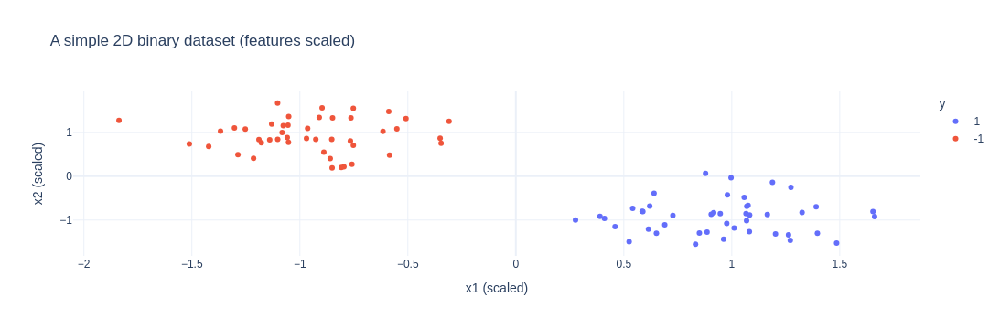

In [2]:
# A simple 2D, almost-separable dataset
X, y01 = make_blobs(n_samples=90, centers=2, cluster_std=1.4, random_state=42)
y = np.where(y01 == 0, -1, 1)

scaler = StandardScaler()
Xs = scaler.fit_transform(X)

fig = px.scatter(
    x=Xs[:, 0],
    y=Xs[:, 1],
    color=y.astype(str),
    title="A simple 2D binary dataset (features scaled)",
)
fig.update_layout(xaxis_title="x1 (scaled)", yaxis_title="x2 (scaled)", legend_title="y")
fig

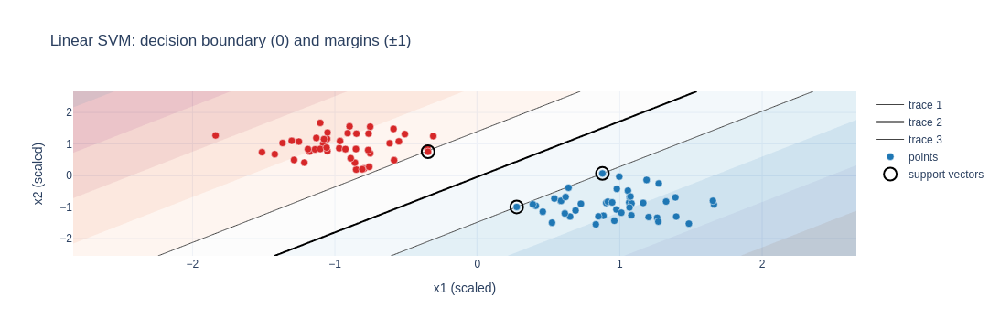

In [3]:
def plot_svm_decision_2d(
    model,
    X2: np.ndarray,
    y2: np.ndarray,
    title: str,
    show_margin: bool = True,
    grid_res: int = 300,
) -> go.Figure:
    x_min, x_max = float(X2[:, 0].min() - 1.0), float(X2[:, 0].max() + 1.0)
    y_min, y_max = float(X2[:, 1].min() - 1.0), float(X2[:, 1].max() + 1.0)

    xs = np.linspace(x_min, x_max, grid_res)
    ys = np.linspace(y_min, y_max, grid_res)
    xx, yy = np.meshgrid(xs, ys)
    grid = np.c_[xx.ravel(), yy.ravel()]
    zz = model.decision_function(grid).reshape(xx.shape)

    fig = go.Figure()

    fig.add_trace(
        go.Contour(
            x=xs,
            y=ys,
            z=zz,
            colorscale="RdBu",
            opacity=0.25,
            showscale=False,
            contours=dict(coloring="fill", showlines=False),
            hoverinfo="skip",
        )
    )

    levels = [-1.0, 0.0, 1.0] if show_margin else [0.0]
    colors = ["#444", "black", "#444"] if show_margin else ["black"]
    widths = [1, 2, 1] if show_margin else [2]
    for level, color, width in zip(levels, colors, widths):
        fig.add_trace(
            go.Contour(
                x=xs,
                y=ys,
                z=zz,
                showscale=False,
                contours=dict(coloring="none", start=level, end=level, size=1),
                line=dict(color=color, width=width),
                hoverinfo="skip",
            )
        )

    colors = np.where(y2 == 1, "#1f77b4", "#d62728")
    fig.add_trace(
        go.Scatter(
            x=X2[:, 0],
            y=X2[:, 1],
            mode="markers",
            marker=dict(size=8, color=colors, line=dict(color="white", width=0.5)),
            name="points",
        )
    )

    if hasattr(model, "support_vectors_"):
        sv = getattr(model, "support_vectors_")
        fig.add_trace(
            go.Scatter(
                x=sv[:, 0],
                y=sv[:, 1],
                mode="markers",
                marker=dict(size=14, symbol="circle-open", color="black", line=dict(width=2)),
                name="support vectors",
            )
        )

    fig.update_layout(
        title=title,
        xaxis_title="x1 (scaled)",
        yaxis_title="x2 (scaled)",
    )
    return fig


clf_linear = SVC(kernel="linear", C=1.0)
clf_linear.fit(Xs, y)

fig = plot_svm_decision_2d(
    clf_linear,
    Xs,
    y,
    title="Linear SVM: decision boundary (0) and margins (±1)",
)
fig

## 2) Lagrange multipliers + KKT (why they show up)

SVMs are built from a **constrained optimization** problem.

### Lagrange multipliers (big idea)

- If you want to minimize $f(\theta)$ subject to an **equality constraint** $g(\theta)=0$, you build a Lagrangian:

$$
\mathcal{L}(\theta,\lambda) = f(\theta) + \lambda\, g(\theta).
$$

At an optimum you get (informally):

- **stationarity**: $\nabla_\theta \mathcal{L}=0$
- **feasibility**: $g(\theta)=0$

### Inequality constraints and KKT

For **inequality constraints** $h(\theta) \le 0$, you introduce multipliers $\alpha \ge 0$:

$$
\mathcal{L}(\theta,\alpha)=f(\theta)+\alpha\,h(\theta).
$$

The KKT conditions include an extra rule:

$$
\alpha\,h(\theta)=0 \quad \text{(complementary slackness)}.
$$

Interpretation:

- If a constraint is **inactive** ($h(\theta)<0$), then it must have **zero weight** ($\alpha=0$).
- Only the **active** constraints can have non-zero multipliers.

This is the heart of the *support vector* story: only a small subset of points (the active constraints) end up with non-zero multipliers.


## 3) Hard-margin SVM (primal ↔ dual)

### Primal (hard margin)

If the data are perfectly separable, the *hard-margin* SVM is:

$$
\min_{w,b}\; \frac{1}{2}\lVert w \rVert^2
\quad \text{s.t.} \quad
y_i (w^T x_i + b) \ge 1\;\;\forall i.
$$

### Lagrangian

Introduce multipliers $\alpha_i \ge 0$ for the constraints:

$$
\mathcal{L}(w,b,\alpha)
=\frac{1}{2}\lVert w \rVert^2 - \sum_i \alpha_i \big(y_i(w^T x_i + b)-1\big).
$$

Stationarity gives:

$$
\frac{\partial \mathcal{L}}{\partial w}=0 \Rightarrow w = \sum_i \alpha_i y_i x_i,
\qquad
\frac{\partial \mathcal{L}}{\partial b}=0 \Rightarrow \sum_i \alpha_i y_i=0.
$$

### Dual (hard margin)

Plugging back yields the dual problem:

$$
\max_{\alpha}\; \sum_i \alpha_i - \frac{1}{2}\sum_i\sum_j \alpha_i\alpha_j y_i y_j \langle x_i,x_j\rangle
\quad\text{s.t.}\quad
\alpha_i\ge 0,\; \sum_i \alpha_i y_i=0.
$$

Key takeaway:

- The solution is expressed in terms of **inner products** $\langle x_i, x_j\rangle$.
- Only points with $\alpha_i>0$ matter → those are the **support vectors**.


In [4]:
# The dual coefficients in sklearn's linear SVC let us *reconstruct* w as a weighted sum of support vectors.
# This is a concrete view of what the Lagrange multipliers are doing.

clf_almost_hard = SVC(kernel="linear", C=1e6)
clf_almost_hard.fit(Xs, y)

w_sklearn = clf_almost_hard.coef_[0]
b_sklearn = float(clf_almost_hard.intercept_[0])

y_alpha = clf_almost_hard.dual_coef_[0]  # shape (n_support,), equals (y_i * alpha_i) for support vectors
sv = clf_almost_hard.support_vectors_
w_from_dual = y_alpha @ sv

print("||w_sklearn - w_from_dual||:", float(np.linalg.norm(w_sklearn - w_from_dual)))
print("b_sklearn:", b_sklearn)
print("n_support:", sv.shape[0])


||w_sklearn - w_from_dual||: 0.0
b_sklearn: -0.04260136446471105
n_support: 3


## 4) Soft margin + the role of `C`

Real data often aren’t perfectly separable. The soft-margin SVM adds slack variables (or equivalently, hinge loss):

$$
\min_{w,b}\; \frac{1}{2}\lVert w \rVert^2 + C\sum_i \max(0, 1 - y_i(w^T x_i + b)).
$$

Mental model:

- **Large `C`**: cares a lot about misclassifications → tries to fit the training data harder (narrower margin).
- **Small `C`**: tolerates training errors → prefers a wider margin (more regularization).


C=  0.2: train acc=0.838 | support vectors=67
C= 10.0: train acc=0.831 | support vectors=56


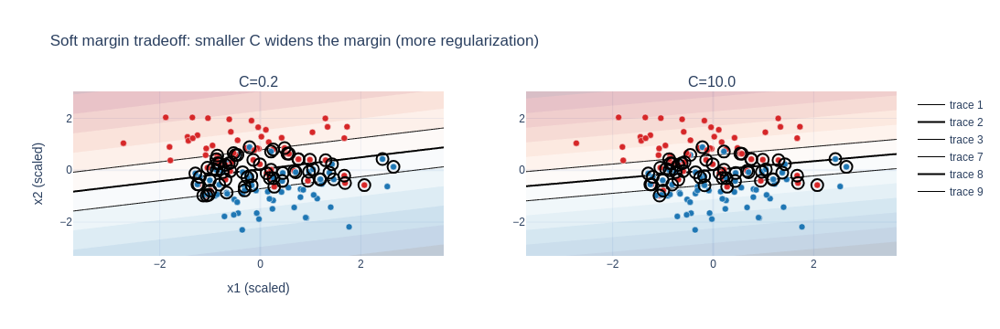

In [5]:
from plotly.subplots import make_subplots

# A noisier dataset to see the C tradeoff
X2, y2_01 = make_blobs(n_samples=130, centers=2, cluster_std=2.3, random_state=0)
y2 = np.where(y2_01 == 0, -1, 1)
Xs2 = StandardScaler().fit_transform(X2)

Cs = [0.2, 10.0]
models = [SVC(kernel="linear", C=C).fit(Xs2, y2) for C in Cs]

for C, m in zip(Cs, models):
    acc = accuracy_score(y2, m.predict(Xs2))
    print(f"C={C:>5}: train acc={acc:.3f} | support vectors={m.support_vectors_.shape[0]}")

fig = make_subplots(rows=1, cols=2, subplot_titles=[f"C={C}" for C in Cs])
for col, m in enumerate(models, start=1):
    x_min, x_max = float(Xs2[:, 0].min() - 1.0), float(Xs2[:, 0].max() + 1.0)
    y_min, y_max = float(Xs2[:, 1].min() - 1.0), float(Xs2[:, 1].max() + 1.0)
    xs = np.linspace(x_min, x_max, 250)
    ys = np.linspace(y_min, y_max, 250)
    xx, yy = np.meshgrid(xs, ys)
    grid = np.c_[xx.ravel(), yy.ravel()]
    zz = m.decision_function(grid).reshape(xx.shape)

    fig.add_trace(
        go.Contour(
            x=xs,
            y=ys,
            z=zz,
            colorscale="RdBu",
            opacity=0.25,
            showscale=False,
            contours=dict(coloring="fill", showlines=False),
            hoverinfo="skip",
        ),
        row=1,
        col=col,
    )

    for level, width in [(-1.0, 1), (0.0, 2), (1.0, 1)]:
        fig.add_trace(
            go.Contour(
                x=xs,
                y=ys,
                z=zz,
                showscale=False,
                contours=dict(coloring="none", start=level, end=level, size=1),
                line=dict(color="black", width=width),
                hoverinfo="skip",
            ),
            row=1,
            col=col,
        )

    colors = np.where(y2 == 1, "#1f77b4", "#d62728")
    fig.add_trace(
        go.Scatter(
            x=Xs2[:, 0],
            y=Xs2[:, 1],
            mode="markers",
            marker=dict(size=7, color=colors, line=dict(color="white", width=0.5)),
            showlegend=False,
        ),
        row=1,
        col=col,
    )
    sv = m.support_vectors_
    fig.add_trace(
        go.Scatter(
            x=sv[:, 0],
            y=sv[:, 1],
            mode="markers",
            marker=dict(size=13, symbol="circle-open", color="black", line=dict(width=2)),
            showlegend=False,
        ),
        row=1,
        col=col,
    )

fig.update_layout(
    title="Soft margin tradeoff: smaller C widens the margin (more regularization)",
    xaxis_title="x1 (scaled)",
    yaxis_title="x2 (scaled)",
)
fig

## 5) Kernels + the kernel trick (RBF / poly / ...)

The dual SVM objective depends on the data only through **inner products**:

$$
\langle x_i, x_j \rangle.
$$

If we first map inputs to a feature space $\phi(x)$, the inner product becomes:

$$
\langle \phi(x_i), \phi(x_j) \rangle.
$$

A **kernel** is any function $K$ that *acts like* that inner product:

$$
K(x,z) = \langle \phi(x), \phi(z) \rangle.
$$

This is the kernel trick: we get non-linear decision boundaries without ever explicitly building $\phi(x)$.

Common kernels:

- Linear: $K(x,z) = x^T z$
- Polynomial: $K(x,z) = (\gamma x^T z + c_0)^{d}$
- RBF / Gaussian: $K(x,z)=\exp(-\gamma\lVert x-z \rVert^2)$
- Sigmoid: $K(x,z)=\tanh(\gamma x^T z + c_0)$

Key parameters:

- `gamma`: sets the length-scale (larger \(\gamma\) means “more local” influence)
- `degree`: polynomial complexity
- `coef0`: shifts polynomial/sigmoid


In [6]:
KernelName = Literal["linear", "poly", "rbf"]


def _gamma_scale(X: np.ndarray) -> float:
    # sklearn's default for RBF/poly/sigmoid is gamma='scale': 1 / (n_features * X.var())
    return 1.0 / (X.shape[1] * float(X.var()))


def linear_kernel(X: np.ndarray, Z: np.ndarray) -> np.ndarray:
    return X @ Z.T


def polynomial_kernel(
    X: np.ndarray,
    Z: np.ndarray,
    degree: int = 3,
    gamma: float | None = None,
    coef0: float = 1.0,
) -> np.ndarray:
    gamma = _gamma_scale(X) if gamma is None else float(gamma)
    return (gamma * (X @ Z.T) + coef0) ** degree


def rbf_kernel(X: np.ndarray, Z: np.ndarray, gamma: float | None = None) -> np.ndarray:
    gamma = _gamma_scale(X) if gamma is None else float(gamma)
    X_norm = np.sum(X**2, axis=1)[:, None]
    Z_norm = np.sum(Z**2, axis=1)[None, :]
    dist2 = X_norm + Z_norm - 2.0 * (X @ Z.T)
    return np.exp(-gamma * dist2)


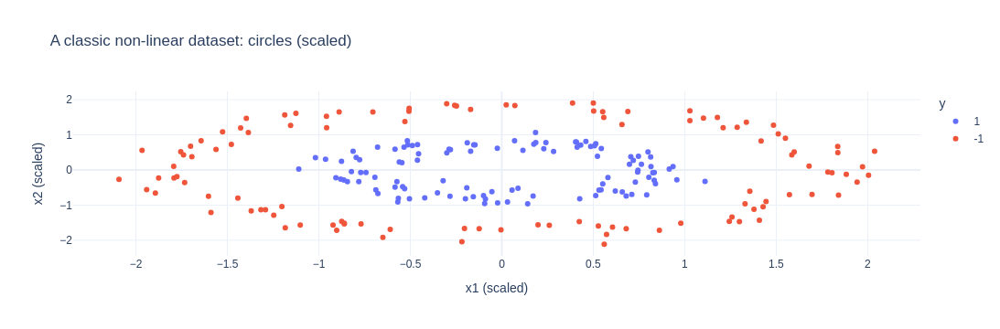

In [7]:
# Non-linearly separable dataset
Xc, yc01 = make_circles(n_samples=220, factor=0.45, noise=0.08, random_state=42)
yc = np.where(yc01 == 0, -1, 1)
Xcs = StandardScaler().fit_transform(Xc)

fig = px.scatter(
    x=Xcs[:, 0],
    y=Xcs[:, 1],
    color=yc.astype(str),
    title="A classic non-linear dataset: circles (scaled)",
)
fig.update_layout(xaxis_title="x1 (scaled)", yaxis_title="x2 (scaled)", legend_title="y")
fig

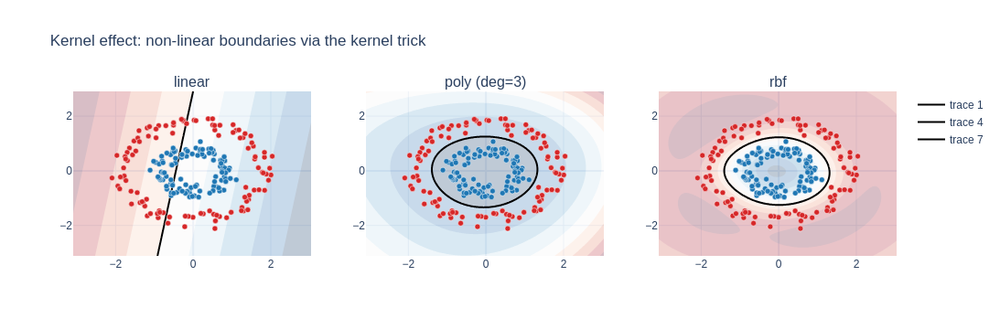

In [8]:
from plotly.subplots import make_subplots

configs = [
    ("linear", dict(kernel="linear")),
    ("poly (deg=3)", dict(kernel="poly", degree=3, gamma="scale", coef0=1.0)),
    ("rbf", dict(kernel="rbf", gamma="scale")),
]

fig = make_subplots(rows=1, cols=3, subplot_titles=[c[0] for c in configs])

for col, (name, params) in enumerate(configs, start=1):
    m = SVC(C=2.0, **params)
    m.fit(Xcs, yc)

    x_min, x_max = float(Xcs[:, 0].min() - 1.0), float(Xcs[:, 0].max() + 1.0)
    y_min, y_max = float(Xcs[:, 1].min() - 1.0), float(Xcs[:, 1].max() + 1.0)
    xs = np.linspace(x_min, x_max, 260)
    ys = np.linspace(y_min, y_max, 260)
    xx, yy = np.meshgrid(xs, ys)
    grid = np.c_[xx.ravel(), yy.ravel()]
    zz = m.decision_function(grid).reshape(xx.shape)

    fig.add_trace(
        go.Contour(
            x=xs,
            y=ys,
            z=zz,
            colorscale="RdBu",
            opacity=0.25,
            showscale=False,
            contours=dict(coloring="fill", showlines=False),
            hoverinfo="skip",
        ),
        row=1,
        col=col,
    )
    fig.add_trace(
        go.Contour(
            x=xs,
            y=ys,
            z=zz,
            showscale=False,
            contours=dict(coloring="none", start=0.0, end=0.0, size=1),
            line=dict(color="black", width=2),
            hoverinfo="skip",
        ),
        row=1,
        col=col,
    )

    colors = np.where(yc == 1, "#1f77b4", "#d62728")
    fig.add_trace(
        go.Scatter(
            x=Xcs[:, 0],
            y=Xcs[:, 1],
            mode="markers",
            marker=dict(size=6, color=colors, line=dict(color="white", width=0.5)),
            showlegend=False,
        ),
        row=1,
        col=col,
    )

fig.update_layout(title="Kernel effect: non-linear boundaries via the kernel trick")
fig

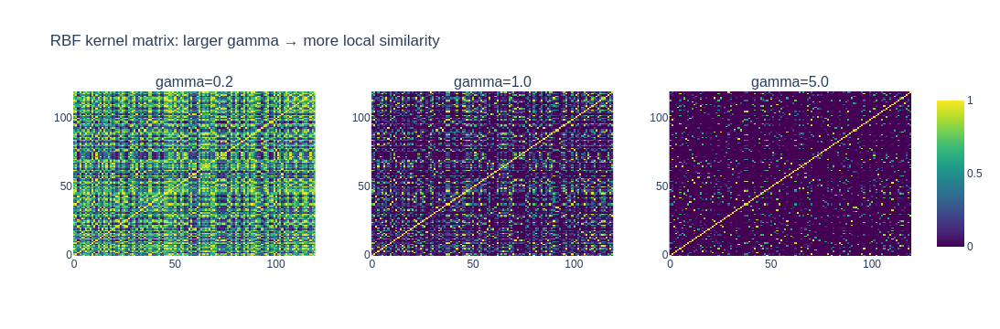

In [9]:
# RBF gamma controls locality. Here's what the kernel similarity matrix looks like.

Xk = Xcs[:120]
gammas = [0.2, 1.0, 5.0]

fig = make_subplots(rows=1, cols=3, subplot_titles=[f"gamma={g}" for g in gammas])
for col, g in enumerate(gammas, start=1):
    K = rbf_kernel(Xk, Xk, gamma=g)
    fig.add_trace(go.Heatmap(z=K, colorscale="Viridis", showscale=(col == 3)), row=1, col=col)

fig.update_layout(title="RBF kernel matrix: larger gamma → more local similarity")
fig

## 6) SVM classification from scratch (simplified SMO)

The soft-margin dual (with kernels) is a quadratic program:

$$
\max_{\alpha}\; \sum_i \alpha_i - \frac{1}{2}\sum_i\sum_j \alpha_i\alpha_j y_i y_j K(x_i,x_j)
\quad\text{s.t.}\quad
0 \le \alpha_i \le C,\; \sum_i \alpha_i y_i=0.
$$

A classic way to solve this efficiently is **SMO (Sequential Minimal Optimization)**: repeatedly update two multipliers at a time while keeping constraints satisfied.

Below is a **learning-oriented** (not production-optimized) SMO-style implementation.


In [10]:
@dataclass
class KernelSVMClassifierSMO:
    C: float = 1.0
    kernel: KernelName = "rbf"
    degree: int = 3
    gamma: float | None = None
    coef0: float = 1.0
    tol: float = 1e-3
    max_passes: int = 10
    max_iter: int = 10_000
    random_state: int = 42

    def _kernel_matrix(self, X: np.ndarray, Z: np.ndarray) -> np.ndarray:
        if self.kernel == "linear":
            return linear_kernel(X, Z)
        if self.kernel == "poly":
            return polynomial_kernel(X, Z, degree=self.degree, gamma=self.gamma, coef0=self.coef0)
        if self.kernel == "rbf":
            return rbf_kernel(X, Z, gamma=self.gamma)
        raise ValueError(f"Unknown kernel: {self.kernel}")

    def fit(self, X: np.ndarray, y: np.ndarray) -> "KernelSVMClassifierSMO":
        X = np.asarray(X, dtype=float)
        y = np.asarray(y, dtype=float)
        y = np.where(y <= 0, -1.0, 1.0)

        n = X.shape[0]
        self.X_ = X
        self.y_ = y
        self.alphas_ = np.zeros(n)
        self.b_ = 0.0
        self.K_ = self._kernel_matrix(X, X)

        rng_local = np.random.default_rng(self.random_state)

        def f_i(i: int) -> float:
            return float((self.alphas_ * self.y_) @ self.K_[:, i] + self.b_)

        passes = 0
        it = 0

        while passes < self.max_passes and it < self.max_iter:
            num_changed = 0
            for i in range(n):
                Ei = f_i(i) - float(y[i])
                ai = self.alphas_[i]

                violates = (y[i] * Ei < -self.tol and ai < self.C) or (y[i] * Ei > self.tol and ai > 0)
                if not violates:
                    continue

                j = int(rng_local.integers(0, n - 1))
                if j >= i:
                    j += 1

                Ej = f_i(j) - float(y[j])
                aj = self.alphas_[j]

                ai_old, aj_old = ai, aj

                if y[i] != y[j]:
                    L = max(0.0, aj_old - ai_old)
                    H = min(self.C, self.C + aj_old - ai_old)
                else:
                    L = max(0.0, ai_old + aj_old - self.C)
                    H = min(self.C, ai_old + aj_old)
                if L == H:
                    continue

                eta = 2.0 * self.K_[i, j] - self.K_[i, i] - self.K_[j, j]
                if eta >= 0:
                    continue

                aj_new = aj_old - y[j] * (Ei - Ej) / eta
                aj_new = float(np.clip(aj_new, L, H))
                if abs(aj_new - aj_old) < 1e-5:
                    continue

                ai_new = ai_old + y[i] * y[j] * (aj_old - aj_new)

                b1 = (
                    self.b_
                    - Ei
                    - y[i] * (ai_new - ai_old) * self.K_[i, i]
                    - y[j] * (aj_new - aj_old) * self.K_[i, j]
                )
                b2 = (
                    self.b_
                    - Ej
                    - y[i] * (ai_new - ai_old) * self.K_[i, j]
                    - y[j] * (aj_new - aj_old) * self.K_[j, j]
                )

                if 0 < ai_new < self.C:
                    b_new = b1
                elif 0 < aj_new < self.C:
                    b_new = b2
                else:
                    b_new = 0.5 * (b1 + b2)

                self.alphas_[i] = ai_new
                self.alphas_[j] = aj_new
                self.b_ = float(b_new)
                num_changed += 1

            passes = passes + 1 if num_changed == 0 else 0
            it += 1

        self.support_ = np.where(self.alphas_ > 1e-8)[0]
        self.support_vectors_ = self.X_[self.support_]
        return self

    def decision_function(self, X: np.ndarray) -> np.ndarray:
        X = np.asarray(X, dtype=float)
        K = self._kernel_matrix(self.X_, X)
        return (self.alphas_ * self.y_) @ K + self.b_

    def predict(self, X: np.ndarray) -> np.ndarray:
        scores = self.decision_function(X)
        return np.where(scores >= 0.0, 1, -1)


scratch acc: 1.000 | support vectors: 22
sklearn acc: 1.000 | support vectors: 22


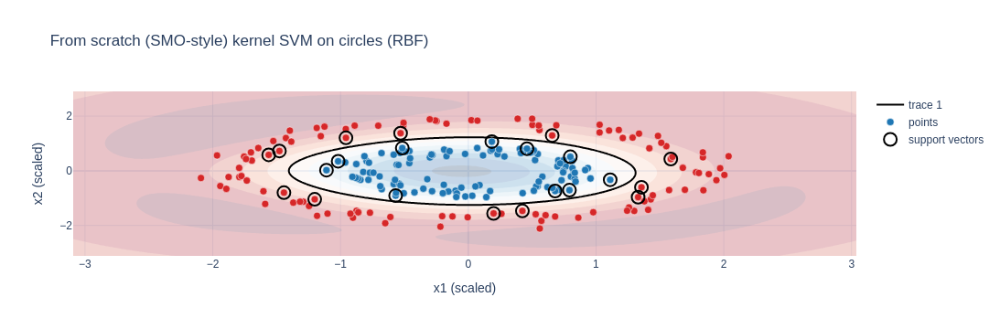

In [11]:
svm_scratch = KernelSVMClassifierSMO(C=2.0, kernel="rbf", gamma=_gamma_scale(Xcs), max_passes=15)
svm_scratch.fit(Xcs, yc)

svm_sklearn = SVC(C=2.0, kernel="rbf", gamma=_gamma_scale(Xcs))
svm_sklearn.fit(Xcs, yc)

acc_scratch = accuracy_score(yc, svm_scratch.predict(Xcs))
acc_sklearn = accuracy_score(yc, svm_sklearn.predict(Xcs))

print(f"scratch acc: {acc_scratch:.3f} | support vectors: {svm_scratch.support_vectors_.shape[0]}")
print(f"sklearn acc: {acc_sklearn:.3f} | support vectors: {svm_sklearn.support_vectors_.shape[0]}")

fig = plot_svm_decision_2d(
    svm_scratch,
    Xcs,
    yc,
    title="From scratch (SMO-style) kernel SVM on circles (RBF)",
    show_margin=False,
)
fig

## 7) Support Vector Regression (SVR): ε-tube + dual

SVR is the regression sibling of SVC. Instead of separating classes, it fits a function while ignoring small errors.

### Intuition: the ε-insensitive tube

SVR tries to find a function $f(x)$ such that most points lie within an $ε$-tube:

$$
|y_i - f(x_i)| \le \epsilon.
$$

Errors smaller than $\epsilon$ are treated as **free**. Points that touch or break the tube become support vectors.

### Primal (soft margin)

One common form is:

$$
\min_{w,b}\; \frac{1}{2}\lVert w \rVert^2 + C\sum_i \max\big(0,\;|y_i-(w^T x_i+b)|-\epsilon\big).
$$

### Dual (why SVR also has support vectors)

The dual uses two sets of multipliers $(\alpha_i, \alpha_i^*)$ (for the upper and lower tube constraints). The learned function becomes:

$$
f(x)=\sum_i (\alpha_i-\alpha_i^*)\,K(x_i,x) + b.
$$

Below we set up and solve this dual for a small dataset using `scipy.optimize` (again: learning-oriented, not production-optimized).


In [12]:
@dataclass
class KernelSVRQP:
    C: float = 1.0
    epsilon: float = 0.1
    kernel: KernelName = "rbf"
    degree: int = 3
    gamma: float | None = None
    coef0: float = 1.0
    tol: float = 1e-8
    max_iter: int = 2000

    def _kernel_matrix(self, X: np.ndarray, Z: np.ndarray) -> np.ndarray:
        if self.kernel == "linear":
            return linear_kernel(X, Z)
        if self.kernel == "poly":
            return polynomial_kernel(X, Z, degree=self.degree, gamma=self.gamma, coef0=self.coef0)
        if self.kernel == "rbf":
            return rbf_kernel(X, Z, gamma=self.gamma)
        raise ValueError(f"Unknown kernel: {self.kernel}")

    def fit(self, X: np.ndarray, y: np.ndarray) -> "KernelSVRQP":
        X = np.asarray(X, dtype=float)
        y = np.asarray(y, dtype=float)

        n = X.shape[0]
        self.X_ = X
        self.y_ = y
        K = self._kernel_matrix(X, X)

        # variables are a = [alpha, alpha*] (length 2n)
        def objective(a: np.ndarray) -> float:
            alpha = a[:n]
            alpha_star = a[n:]
            beta = alpha - alpha_star
            # We *minimize* the negative dual (a convex QP in this form):
            # 0.5 * beta^T K beta + epsilon * sum(alpha + alpha*) - y^T beta
            return 0.5 * float(beta @ K @ beta) + self.epsilon * float(np.sum(alpha + alpha_star)) - float(y @ beta)

        def grad(a: np.ndarray) -> np.ndarray:
            alpha = a[:n]
            alpha_star = a[n:]
            beta = alpha - alpha_star
            g_beta = K @ beta
            g_alpha = g_beta + self.epsilon - y
            g_alpha_star = -g_beta + self.epsilon + y
            return np.concatenate([g_alpha, g_alpha_star])

        cons = {
            "type": "eq",
            "fun": lambda a: float(np.sum(a[:n] - a[n:])),
            "jac": lambda a: np.concatenate([np.ones(n), -np.ones(n)]),
        }
        bounds = [(0.0, self.C) for _ in range(2 * n)]
        x0 = np.zeros(2 * n)

        res = minimize(
            objective,
            x0,
            method="SLSQP",
            jac=grad,
            bounds=bounds,
            constraints=[cons],
            options={"ftol": self.tol, "maxiter": self.max_iter, "disp": False},
        )
        if not res.success:
            print("Warning: optimizer did not fully converge:", res.message)

        a = np.asarray(res.x)
        self.alpha_ = a[:n]
        self.alpha_star_ = a[n:]
        self.beta_ = self.alpha_ - self.alpha_star_

        # Compute intercept b using KKT conditions:
        # - if 0 < alpha_i < C: f(x_i) = y_i - epsilon
        # - if 0 < alpha*_i < C: f(x_i) = y_i + epsilon
        f_no_b = self.beta_ @ K  # shape (n,)

        tol = 1e-6
        mask_up = (self.alpha_ > tol) & (self.alpha_ < self.C - tol)
        mask_lo = (self.alpha_star_ > tol) & (self.alpha_star_ < self.C - tol)

        b_vals = []
        for i in np.where(mask_up)[0]:
            b_vals.append(y[i] - self.epsilon - f_no_b[i])
        for i in np.where(mask_lo)[0]:
            b_vals.append(y[i] + self.epsilon - f_no_b[i])

        self.b_ = float(np.mean(b_vals)) if b_vals else float(np.mean(y - f_no_b))
        self.support_ = np.where(np.abs(self.beta_) > tol)[0]
        return self

    def predict(self, X: np.ndarray) -> np.ndarray:
        X = np.asarray(X, dtype=float)
        K = self._kernel_matrix(self.X_, X)
        return self.beta_ @ K + self.b_


scratch SVR: MSE= 0.01262595102773146 R2= 0.977980144024106
sklearn  SVR: MSE= 0.012624597718471414 R2= 0.977982504216612
scratch support vectors: 23
sklearn support vectors: 23


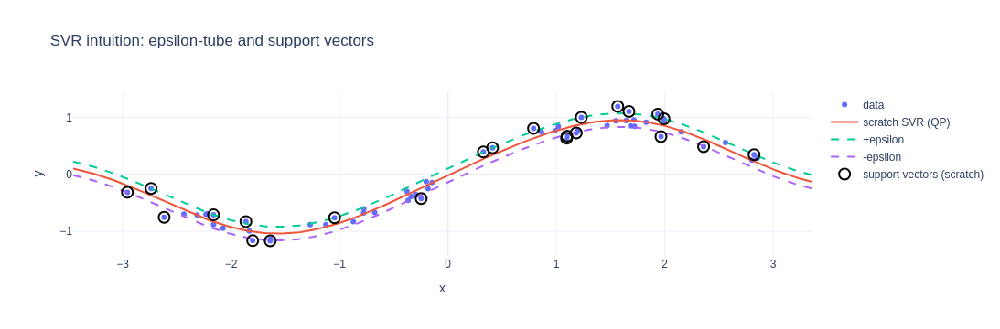

In [13]:
# A 1D regression dataset
n = 60
Xr = np.sort(rng.uniform(-3.0, 3.0, size=n)).reshape(-1, 1)
yr = np.sin(Xr[:, 0]) + 0.15 * rng.normal(size=n)

x_scaler = StandardScaler()
Xrs = x_scaler.fit_transform(Xr)

x_grid = np.linspace(Xr.min() - 0.5, Xr.max() + 0.5, 400).reshape(-1, 1)
x_grid_s = x_scaler.transform(x_grid)

C = 6.0
epsilon = 0.12
gamma = _gamma_scale(Xrs)

svr_qp = KernelSVRQP(C=C, epsilon=epsilon, kernel="rbf", gamma=gamma)
svr_qp.fit(Xrs, yr)

svr_sk = SVR(C=C, epsilon=epsilon, kernel="rbf", gamma=gamma)
svr_sk.fit(Xrs, yr)

pred_qp = svr_qp.predict(x_grid_s)
pred_sk = svr_sk.predict(x_grid_s)

train_pred_qp = svr_qp.predict(Xrs)
train_pred_sk = svr_sk.predict(Xrs)

print("scratch SVR: MSE=", mean_squared_error(yr, train_pred_qp), "R2=", r2_score(yr, train_pred_qp))
print("sklearn  SVR: MSE=", mean_squared_error(yr, train_pred_sk), "R2=", r2_score(yr, train_pred_sk))
print("scratch support vectors:", len(svr_qp.support_))
print("sklearn support vectors:", len(svr_sk.support_))

fig = go.Figure()
fig.add_trace(go.Scatter(x=Xr[:, 0], y=yr, mode="markers", name="data"))

fig.add_trace(go.Scatter(x=x_grid[:, 0], y=pred_qp, mode="lines", name="scratch SVR (QP)"))
fig.add_trace(
    go.Scatter(
        x=x_grid[:, 0],
        y=pred_qp + epsilon,
        mode="lines",
        line=dict(dash="dash"),
        name="+epsilon",
    )
)
fig.add_trace(
    go.Scatter(
        x=x_grid[:, 0],
        y=pred_qp - epsilon,
        mode="lines",
        line=dict(dash="dash"),
        name="-epsilon",
    )
)

sv_idx = svr_qp.support_
fig.add_trace(
    go.Scatter(
        x=Xr[sv_idx, 0],
        y=yr[sv_idx],
        mode="markers",
        marker=dict(size=12, symbol="circle-open", color="black", line=dict(width=2)),
        name="support vectors (scratch)",
    )
)

fig.update_layout(
    title="SVR intuition: epsilon-tube and support vectors",
    xaxis_title="x",
    yaxis_title="y",
)
fig

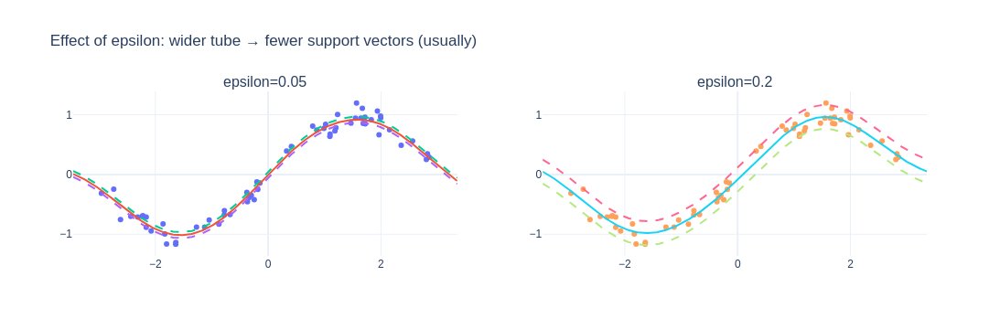

In [14]:
# Epsilon controls tube width; gamma controls smoothness (for RBF).

epsilons = [0.05, 0.2]
fig = make_subplots(rows=1, cols=2, subplot_titles=[f"epsilon={e}" for e in epsilons])

for col, e in enumerate(epsilons, start=1):
    m = SVR(C=6.0, epsilon=e, kernel="rbf", gamma=gamma)
    m.fit(Xrs, yr)
    pred = m.predict(x_grid_s)

    fig.add_trace(go.Scatter(x=Xr[:, 0], y=yr, mode="markers", showlegend=False), row=1, col=col)
    fig.add_trace(go.Scatter(x=x_grid[:, 0], y=pred, mode="lines", showlegend=False), row=1, col=col)
    fig.add_trace(
        go.Scatter(x=x_grid[:, 0], y=pred + e, mode="lines", line=dict(dash="dash"), showlegend=False),
        row=1,
        col=col,
    )
    fig.add_trace(
        go.Scatter(x=x_grid[:, 0], y=pred - e, mode="lines", line=dict(dash="dash"), showlegend=False),
        row=1,
        col=col,
    )

fig.update_layout(title="Effect of epsilon: wider tube → fewer support vectors (usually)")
fig

## 8) `scikit-learn` SVMs: practical parameter map

### Picking the estimator

- `SVC`: kernel SVM classification (powerful, but training scales poorly with very large datasets)
- `LinearSVC`: linear SVM classification (faster for large/high-dimensional problems)
- `SVR`: kernel SVR regression
- `LinearSVR`: linear SVR regression

### Key parameters (mental model)

- `C` (SVC/SVR): regularization strength
  - small `C` → wider margin / more regularization
  - large `C` → tighter fit to training data
- `kernel`:
  - `linear` for linear problems or very high-dimensional sparse features
  - `rbf` is a strong default for non-linear problems
- `gamma` (rbf/poly/sigmoid): locality / smoothness
  - in sklearn, default is `gamma='scale'` meaning $1/(d\,\mathrm{Var}(X))$
- `degree` (poly): polynomial complexity
- `coef0` (poly/sigmoid): shifts the kernel
- `epsilon` (SVR): width of the ε-tube
- `class_weight` (SVC): handle class imbalance
- `probability=True` (SVC): enables probabilities via extra calibration work (slower)

### Always scale your features

SVMs are very sensitive to feature scales. Use `StandardScaler` (or domain-appropriate scaling) inside a pipeline.


In [15]:
from sklearn.pipeline import make_pipeline

# Canonical patterns

svc = make_pipeline(StandardScaler(), SVC(C=1.0, kernel="rbf", gamma="scale"))
svr = make_pipeline(StandardScaler(), SVR(C=5.0, kernel="rbf", gamma="scale", epsilon=0.1))

print(svc)
print(svr)


Pipeline(steps=[('standardscaler', StandardScaler()), ('svc', SVC())])
Pipeline(steps=[('standardscaler', StandardScaler()), ('svr', SVR(C=5.0))])


## Exercises

1. On the circles dataset, sweep over `gamma` (small → large) and plot how the number of support vectors changes.
2. Make a dataset with outliers and compare SVR with different `epsilon` values. Which settings treat the outliers as support vectors?
3. Implement a one-vs-rest wrapper around the scratch SVM classifier and test it on a 3-class dataset.
4. Explain in your own words how complementary slackness connects to the idea of “only support vectors matter”.


## References

- Cortes, Vapnik (1995): *Support-vector networks*
- Smola, Schölkopf (2004): *A tutorial on support vector regression*
- Platt (1998): *Sequential Minimal Optimization: A Fast Algorithm for Training SVMs*
- `scikit-learn` docs: `sklearn.svm.SVC`, `sklearn.svm.SVR`
